<a href="https://colab.research.google.com/github/mikhaelos11/Amplitude-envelope-for-audio-signal/blob/master/Infasuratoarea_unui_semnal_audio_(amplitude_envelope).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import librosa
import librosa.display as ipd
import matplotlib.pyplot as plt
import numpy as np
import IPython.display as ipd

In [2]:
#extragere fisiere audio
edm_exemplu = "slavija.wav"
jazz_exemplu = "saxofon.wav"
live_exemplu = "roses.wav"

In [3]:
ipd.Audio(edm_exemplu)

In [4]:
ipd.Audio(jazz_exemplu)

In [6]:
ipd.Audio(live_exemplu)

In [7]:
#re = rata de esantionare(sampling rate)
edm, re = librosa.load(edm_exemplu)
jazz, _ = librosa.load(jazz_exemplu)
live, _ = librosa.load(live_exemplu)

In [8]:
#esantioanele sunt covertite in valori zecimale si stocate sub forma de array
print(edm)

[ 0.16873336  0.1457862   0.08191973 ...  0.0129532  -0.08879498
  0.        ]


In [9]:
#numarul de esantioane
print(edm.size)
print(jazz.size)
print(live.size)


660701
665867
658746


In [10]:
#durata unui esantion
durata_esantion = 1 / re
print(f"durata unui esantion este:{durata_esantion:.6f} secunde" )

durata unui esantion este:0.000045 secunde


In [11]:
#durata semnalului audio in secunde
durata = durata_esantion * len(edm)
print(f"Durata semnalului audio este:{durata:.2f} secunde")

Durata semnalului audio este:29.96 secunde


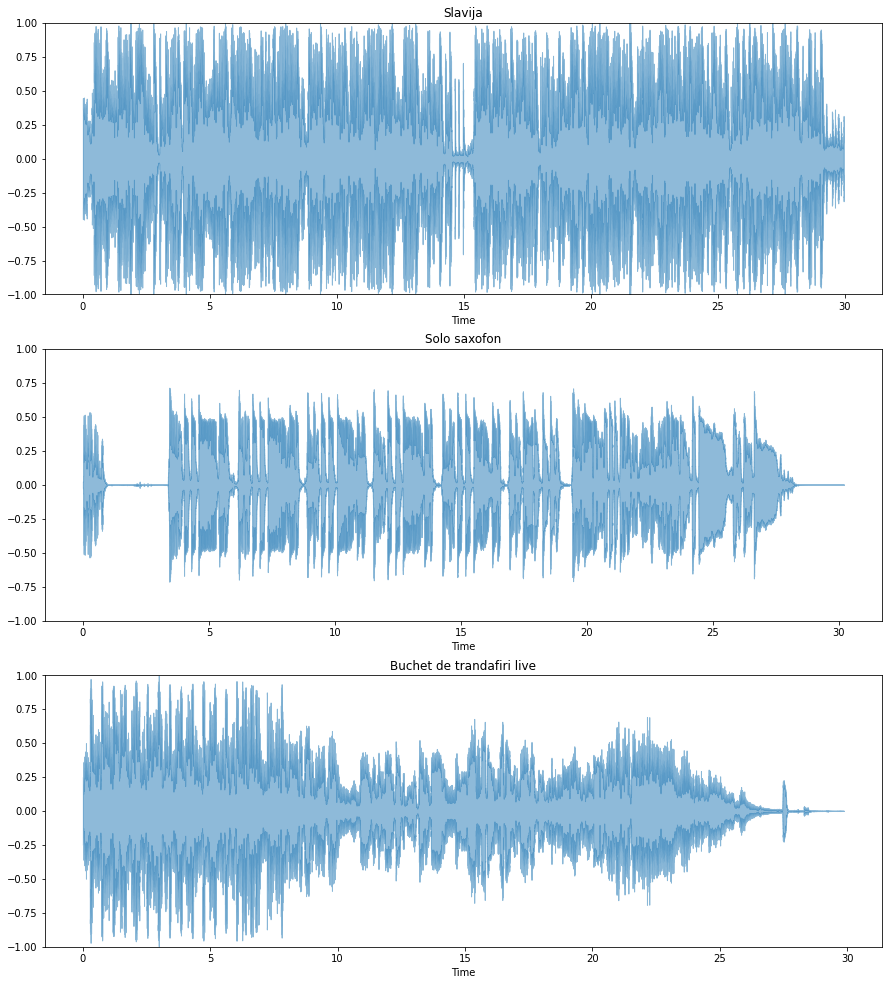

In [12]:
#Vizualizarea semnalului in domeniul timp
plt.figure(figsize=(15,17))
plt.subplot(3,1,1)
librosa.display.waveshow(edm, alpha=0.5)
plt.title("Slavija")
plt.ylim((-1, 1))

plt.subplot(3,1,2)
librosa.display.waveshow(jazz, alpha=0.5)
plt.title("Solo saxofon")
plt.ylim((-1, 1))

plt.subplot(3,1,3)
librosa.display.waveshow(live, alpha=0.5)
plt.title("Buchet de trandafiri live")
plt.ylim((-1, 1))
plt.show()

In [ ]:
#calcularea infasuratoarei (amplitude envelope)
MARIME_CADRU = 1024
LUNGIME_PAS = 512
def infasuratoare(semnal, marime_cadru, lungime_pas):
    infasuratoare = []

    #calculam infasuratoarea pentru fiecare cadru
    for i in range(0, len(semnal), lungime_pas):
        cadru_curent_al_infasuratorii = max(semnal[i:i+marime_cadru])
        infasuratoare.append(cadru_curent_al_infasuratorii)

    return np.array(infasuratoare)

In [ ]:
#metoda este aceeasi cu cea precedenta
def fancy_infasuratoare(semnal, marime_cadru, lungime_pas):
    return np.array([max(semnal[i:i+marime_cadru]) for i in range(0, semnal.size, lungime_pas)])

#infasuratoarea fiecarui semnal pentru cadre care nu se suprapun
inf_edm = infasuratoare(edm, MARIME_CADRU, LUNGIME_PAS)
print(f"numarul total1 de cadre al semnalului edm este:{len(inf_edm)}")

inf_jazz = infasuratoare(jazz, MARIME_CADRU, LUNGIME_PAS)
print(f"numarul total de cadre al semnalului jazz este:{len(inf_jazz)}")

inf_live = infasuratoare(live, MARIME_CADRU, LUNGIME_PAS)
print(f"numarul total de cadre al semnalului live este:{len(inf_live)}")

fancy_inf_edm = fancy_infasuratoare(edm, MARIME_CADRU, LUNGIME_PAS)
print(f"numarul total2 de cadre al semnalului edm este:{len(inf_edm)}")

print((inf_edm == fancy_inf_edm).all()) #verificam daca valorile returnate sunt aceleasi pentru fiecare cadru

numarul total1 de cadre al semnalului edm este:1291
numarul total de cadre al semnalului jazz este:1301
numarul total de cadre al semnalului live este:1287
numarul total2 de cadre al semnalului edm este:1291
True


In [ ]:
#vizualizarea infasuratorii pentru fiecare semnal
cadre = range(0, inf_edm.size)
t = librosa.frames_to_time(cadre, hop_length=LUNGIME_PAS)

plt.figure(figsize=(15,17))

axa = plt.subplot(3,1,1)
librosa.display.waveshow(edm, alpha=0.5)
plt.plot(t, inf_edm, color='r')
plt.title("Slavija")
plt.ylim((-1, 1))

cadre = range(0, inf_jazz.size)
t = librosa.frames_to_time(cadre, hop_length=LUNGIME_PAS)
plt.subplot(3,1,2)
librosa.display.waveshow(jazz, alpha=0.5)
plt.plot(t, inf_jazz, color='r')
plt.title("Solo saxofon")
plt.ylim((-1, 1))

cadre = range(0, inf_live.size)
t = librosa.frames_to_time(cadre, hop_length=LUNGIME_PAS)
plt.subplot(3,1,3)
librosa.display.waveshow(live, alpha=0.5)
plt.plot(t, inf_live, color='r')
plt.title("Buchet de trandafiri live")
plt.ylim((-1, 1))

plt.show()


NameError: ignored